# Deep Convolutional Generative Adversarial Network

This tutorial demonstrates how to generate images of handwritten digits using a [Deep Convolutional Generative Adversarial Network](https://arxiv.org/pdf/1511.06434.pdf) (DCGAN). The code is written using the [Keras Sequential API](https://www.tensorflow.org/guide/keras) with a `tf.GradientTape` training loop.

In [1]:
# originals:
"""
dcgan: https://colab.research.google.com/github/tensorflow/docs/blob/master/site/en/tutorials/generative/dcgan.ipynb#scrollTo=ZBwyU6t2Wf3g
architecture: https://www.kaggle.com/code/thuylinh225/generate-monet-images-using-dcgan
naming convention: https://github.com/thashimoto1998/DCGAN/blob/master/dcgan.py

"""

'\ndcgan: https://colab.research.google.com/github/tensorflow/docs/blob/master/site/en/tutorials/generative/dcgan.ipynb#scrollTo=ZBwyU6t2Wf3g\narchitecture: https://www.kaggle.com/code/thuylinh225/generate-monet-images-using-dcgan\nnaming convention: https://github.com/thashimoto1998/DCGAN/blob/master/dcgan.py\n\n'

In [2]:
# discriminator: binary_crossentropy

In [3]:
# Normalization: Scaling pixel values to a range (e.g., [0, 1]).
# Resizing: Adjusting the image size if needed.
# Data Augmentation: variations of the images (e.g., rotations, flips) to improve model robustness.

In [4]:
# Import TensorFlow and other libraries

import glob
import imageio
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
import time
import matplotlib.image as mpimg

from IPython import display

In [5]:
import zipfile
import re
from PIL import Image
import shutil
import matplotlib.animation as animation
from IPython.display import HTML

In [6]:
import pandas as pd
import tensorflow.keras as keras
from tensorflow.keras import layers
from tensorflow.keras import optimizers
from tensorflow.keras.utils import plot_model
from tensorflow.keras.initializers import RandomNormal
from tensorflow.keras.models import Sequential, Model, load_model
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Dense, Flatten, Reshape
from tensorflow.keras.layers import BatchNormalization, Dropout
from tensorflow.keras.layers import ReLU, LeakyReLU, Activation
from tensorflow.keras.optimizers import Adam

In [7]:
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    print('Device:', tpu.master())
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.TPUStrategy(tpu)
except Exception as e:
    print("can't initialize tpu, using default, exception: " + str(e))
    strategy = tf.distribute.get_strategy()
print('Number of replicas:', strategy.num_replicas_in_sync)

AUTOTUNE = tf.data.experimental.AUTOTUNE

can't initialize tpu, using default, exception: Please provide a TPU Name to connect to.
Number of replicas: 1


In [8]:
!git clone https://github.com/LyJacky/ImageGeneration.git

Cloning into 'ImageGeneration'...
remote: Enumerating objects: 358, done.
remote: Counting objects: 100% (358/358), done.
remote: Compressing objects: 100% (338/338), done.
remote: Total 358 (delta 22), reused 349 (delta 16), pack-reused 0
Receiving objects: 100% (358/358), 11.53 MiB | 10.10 MiB/s, done.
Resolving deltas: 100% (22/22), done.


In [9]:
# files = glob.glob(f"/content/ImageGeneration/monet_jpg/*.jpg")
data_path = glob.glob(f"/content/ImageGeneration/monet_jpg")

os.chdir(data_path[0])

# iterate through all file
data  = []
for file in os.listdir():
    # Check whether file is in text format or not
    if file.endswith(".jpg"):
        file_path = f"{data_path[0]}/{file}"
        # print(file_path)
        img = mpimg.imread(file_path)
        data.append(img)
        # call read text file function

In [10]:
print(len(data))
print(data[0].shape)

300
(256, 256, 3)


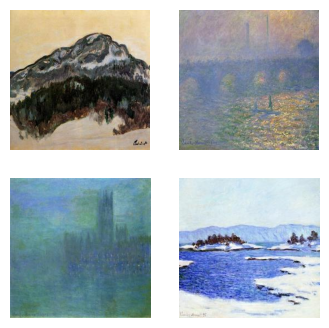

In [11]:
# show some samples

fig = plt.figure(figsize=(4,4))
for i, img in enumerate(data[0:4]):
    plt.subplot(2, 2, i+1)
    plt.imshow(data[i])
    plt.axis('off')
plt.show()

In [12]:
# normalizing the images to [-1, 1]
def normalize(image):
  image = tf.cast(image, tf.float32)
  image = (image / 127.5) - 1
  return image

In [13]:
for val in data:
  val = normalize(val)

In [14]:
print(len(data))
print(data[0].shape)

300
(256, 256, 3)


In [15]:
BATCH_SIZE = 100
BUFFER_SIZE = 300

In [16]:
train_dataset = tf.data.Dataset.from_tensor_slices(data).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

In [17]:
train_dataset

<_BatchDataset element_spec=TensorSpec(shape=(None, 256, 256, 3), dtype=tf.uint8, name=None)>

In [18]:
# modified generator

def make_generator_model():

    generator = Sequential(name="Generator")
    generator.add(Dense(16*16*512,
                        input_shape=(100,)))
    generator.add(Reshape((16,16,512)))

    #layer 2
    generator.add(Conv2DTranspose(filters=256, kernel_size=(5,5), strides=(2,2), padding='same'))
    generator.add(LeakyReLU(alpha=0.2))

    #layer 3
    generator.add(Conv2DTranspose(filters=128, kernel_size=(5,5), strides=(2,2), padding='same'))
    generator.add(LeakyReLU(alpha=0.2))


    #layer 4
    generator.add(Conv2DTranspose(filters=64, kernel_size=(5,5), strides=(2,2), padding='same'))
    generator.add(LeakyReLU(alpha=0.2))

    #layer 5
    generator.add(Conv2DTranspose(filters=32, kernel_size=(5,5), strides=(2,2), padding='same'))
    generator.add(LeakyReLU(alpha=0.2))


    #output
    generator.add(Conv2DTranspose(3, kernel_size=(5,5), activation='tanh', strides=(1,1), padding='same'))

    return generator

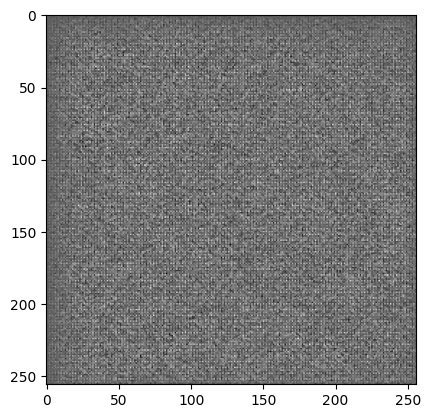

In [19]:
# create noisy image sample
with strategy.scope():
    generator = make_generator_model()
    noise = tf.random.normal([1, 100])
    generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

In [20]:
# Discriminator
def make_discriminator_model():

    discriminator = Sequential()

    #layer 1
    discriminator.add(Conv2D(filters=32, kernel_size=(5, 5), strides=(2, 2), padding='same', input_shape=[256, 256, 3]))
    discriminator.add(LeakyReLU(0.2))

    #layer 2
    discriminator.add(Conv2D(filters=64, kernel_size=(5, 5), strides=(2, 2), padding='same'))
    discriminator.add(BatchNormalization())
    discriminator.add(LeakyReLU(0.2))

    #layer 3
    discriminator.add(Conv2D(filters=128, kernel_size=(5, 5), strides=(2, 2), padding='same'))
    discriminator.add(BatchNormalization())
    discriminator.add(LeakyReLU(0.2))

    #layer 4
    discriminator.add(Conv2D(filters=256, kernel_size=(5, 5), strides=(2, 2), padding='same'))
    discriminator.add(BatchNormalization())
    discriminator.add(LeakyReLU(0.2))

    #layer 5
    discriminator.add(Conv2D(filters=512, kernel_size=(5, 5), strides=(2, 2), padding='same'))
    discriminator.add(BatchNormalization())
    discriminator.add(LeakyReLU(0.2))

    # Flatten and Output Layers
    discriminator.add(Flatten())
    discriminator.add(Dropout(0.3))
    discriminator.add(Dense(1, activation='sigmoid'))
    # discriminator.add(Dense(1, activation='binary_crossentropy'))

    return discriminator


In [21]:
with strategy.scope():
    discriminator = make_discriminator_model()
    decision = discriminator(generated_image)
print (decision)

tf.Tensor([[0.50000566]], shape=(1, 1), dtype=float32)


In [22]:
# This method returns a helper function to compute cross entropy loss
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [23]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

In [24]:
# # create loss function for the generator
# with strategy.scope():
#     def generator_loss(fake_output):
#         cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.NONE)
#         return cross_entropy(tf.ones_like(fake_output), fake_output)

#     # create loss function for the discriminator
#     def discriminator_loss(real_output, fake_output):
#         cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.NONE)
#         real_loss = cross_entropy(tf.ones_like(real_output), real_output)
#         fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
#         total_loss = real_loss + fake_loss
#         return total_loss

In [25]:
with strategy.scope():
    generator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)
    discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)

In [26]:
checkpoint_dir = '/content/training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [27]:
def generate_and_save_images(model, epoch, test_input):
  # Notice `training` is set to False.
  # This is so all layers run in inference mode (batchnorm).
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
      plt.subplot(4, 4, i+1)
      plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5)
      plt.axis('off')

  plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
  plt.show()

In [28]:
def train(dataset, epochs):
  for epoch in range(epochs):
    start = time.time()

    for image_batch in dataset:
      train_step(image_batch)

    # Produce images for the GIF as you go
    display.clear_output(wait=True)
    generate_and_save_images(generator,
                             epoch + 1,
                             seed)

    # Save the model every 15 epochs
    if (epoch + 1) % 15 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print ('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  # Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator,
                           epochs,
                           seed)

In [29]:

noise_dim = 100
num_examples_to_generate = 16

# You will reuse this seed overtime (so it's easier)
# to visualize progress in the animated GIF)
seed = tf.random.normal([num_examples_to_generate, noise_dim])

# Notice the use of `tf.function`
# This annotation causes the function to be "compiled".
@tf.function
def train_step(images):
    noise = tf.random.normal([BATCH_SIZE, noise_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
      generated_images = generator(noise, training=True)

      real_output = discriminator(images, training=True)
      fake_output = discriminator(generated_images, training=True)

      gen_loss = generator_loss(fake_output)
      disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

In [30]:
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [31]:
#training loop
EPOCHS = 50

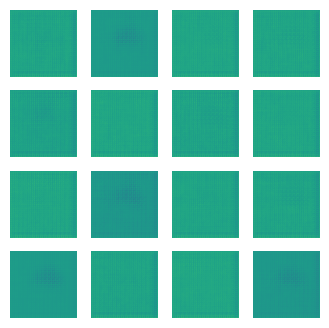

In [32]:
train(train_dataset, EPOCHS)

In [33]:
#gif
# Display a single image using the epoch number
def display_image(epoch_no):
  return PIL.Image.open('image_at_epoch_{:04d}.png'.format(epoch_no))

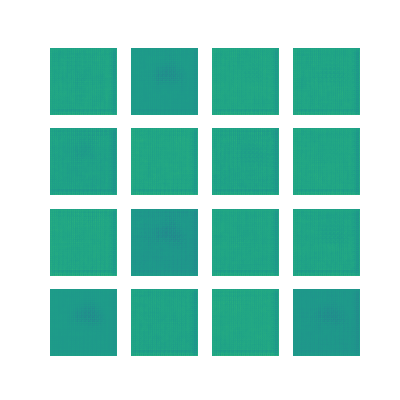

In [34]:
display_image(EPOCHS)

In [35]:
anim_file = 'dcgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

<ipython-input-35-56bb6d34be2e>:7: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
<ipython-input-35-56bb6d34be2e>:9: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


In [36]:
!pip install tensorflow_docs

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 182.5/182.5 kB 5.7 MB/s eta 0:00:00



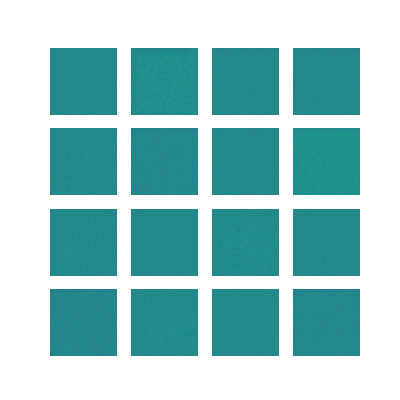

In [37]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)


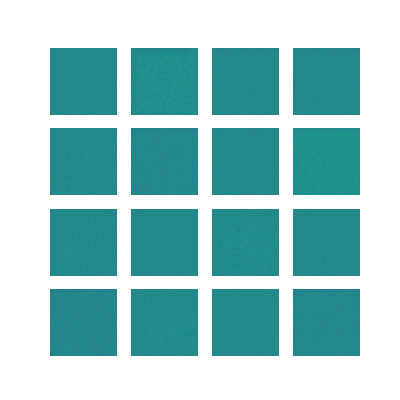

In [38]:
# embed.embed_file(anim_file)

In [ ]:
#############################
###    2nd DCGAN Attempt  ###
#############################

In [46]:
generator2 = make_generator_model()
discriminator2 = make_discriminator_model()
with strategy.scope():
    generator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)
    discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)

In [47]:
class DCGAN_model:
    def __init__(self, noise_dim, EPOCHS, BATCH_SIZE, generator, discriminator, dataset):
        self.noise_dim = noise_dim
        self.EPOCHS = EPOCHS
        self.BATCH_SIZE = BATCH_SIZE
        self.generator = generator
        #self.discriminator = discriminator2
        self.dataset = dataset

    @tf.function
    def train(self, images):

    # Create random noise vector
        noise = tf.random.normal([images.shape[0], noise_dim])

        with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:

        # generate images use random noise vector
            generated_images = self.generator(noise, training=True)

            # use discriminator to evaluate the real and fake images
            real_output = discriminator(images, training=True)
            fake_output = discriminator(generated_images, training=True)
            self.debug(real_output, fake_output)

            # compute generator loss and discriminator loss
            gen_loss = generator_loss(fake_output)
            disc_loss = discriminator_loss(real_output, fake_output)

            # Compute gradients
            gradients_of_generator = gen_tape.gradient(gen_loss, self.generator.trainable_variables)
            gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

            # Update optimizers
            generator_optimizer.apply_gradients(zip(gradients_of_generator, self.generator.trainable_variables))
            discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

        return (gen_loss + disc_loss) * 0.5

    def debug(self, real_output, fake_output):
        print("\t Discrimator real_output: ", real_output)
        print("\t Discrimator fake_output: ", fake_output)

    @tf.function
    def distributed_train(self, images):
        per_replica_losses = strategy.run(self.train, args=(images,))
        return strategy.reduce(tf.distribute.ReduceOp.MEAN, per_replica_losses, axis=None)

    def generate_images(self):
        noise = tf.random.normal([self.BATCH_SIZE, self.noise_dim])
        predictions = self.generator.predict(noise)
        return predictions

    def generate_and_plot_images(self):
        image = self.generate_images()
        gen_imgs = 0.5 * image + 0.5
        fig = plt.figure(figsize=(10, 10))
        for i in range(25):
            plt.subplot(5, 5, i+1)
            plt.imshow(gen_imgs[i, :, :, :])
            plt.axis('off')
        plt.show()

    def train_loop(self):
        e_ls = []
        mean_ls = []
        for epoch in range(self.EPOCHS):
            start = time.time()

            total_loss = 0.0
            num_batches = 0

            for image_batch in self.dataset:
                loss = self.distributed_train(image_batch)
                total_loss += tf.reduce_mean(loss)
                num_batches += 1
            mean_loss = total_loss / num_batches

            if (epoch+1) % 20 == 0:
                print ('Time for epoch {} is {} sec, mean loss is {}'.format(epoch + 1, time.time()-start, mean_loss))
                self.generate_and_plot_images()

                e_ls.append(epoch+1)
                mean_ls.append(mean_loss)
        print("\nMean Loss for every 20 epochs: \n")
        table = pd.DataFrame({"Epoch": e_ls, "Mean Loss": np.array(mean_ls)})
        return table

In [48]:
#training loop
EPOCHS = 600

	 Discrimator real_output:  Tensor("sequential/dense_1/Sigmoid:0", shape=(100, 1), dtype=float32)
	 Discrimator fake_output:  Tensor("sequential/dense_1/Sigmoid_1:0", shape=(100, 1), dtype=float32)
	 Discrimator real_output:  Tensor("sequential/dense_1/Sigmoid:0", shape=(100, 1), dtype=float32)
	 Discrimator fake_output:  Tensor("sequential/dense_1/Sigmoid_1:0", shape=(100, 1), dtype=float32)
Time for epoch 20 is 4.020261287689209 sec, mean loss is 8.30872631072998
4/4 [==============================] - 0s 92ms/step


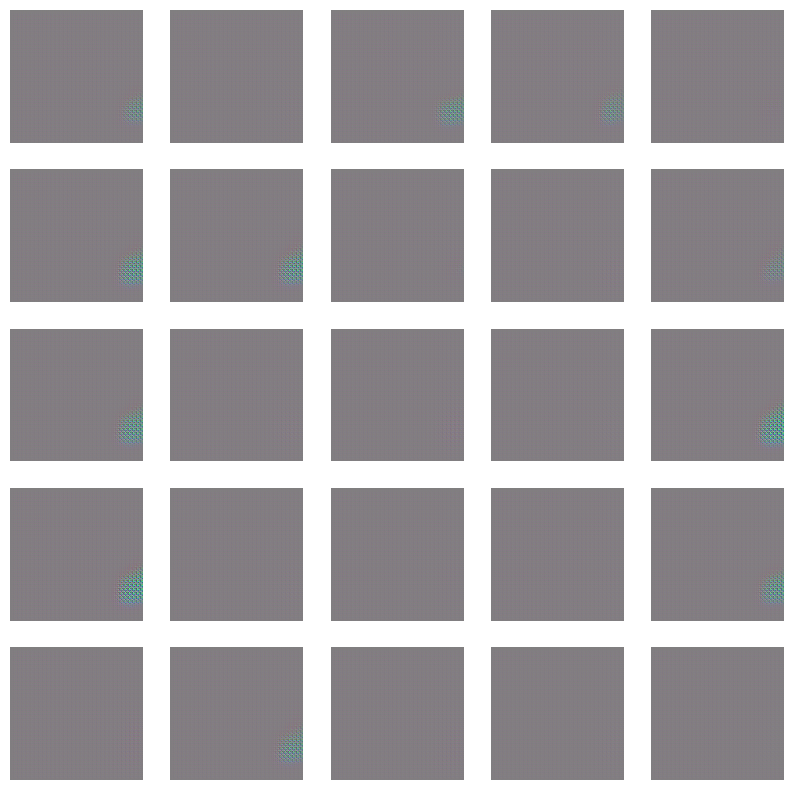

Time for epoch 40 is 4.039577484130859 sec, mean loss is 2.690047025680542
4/4 [==============================] - 0s 92ms/step


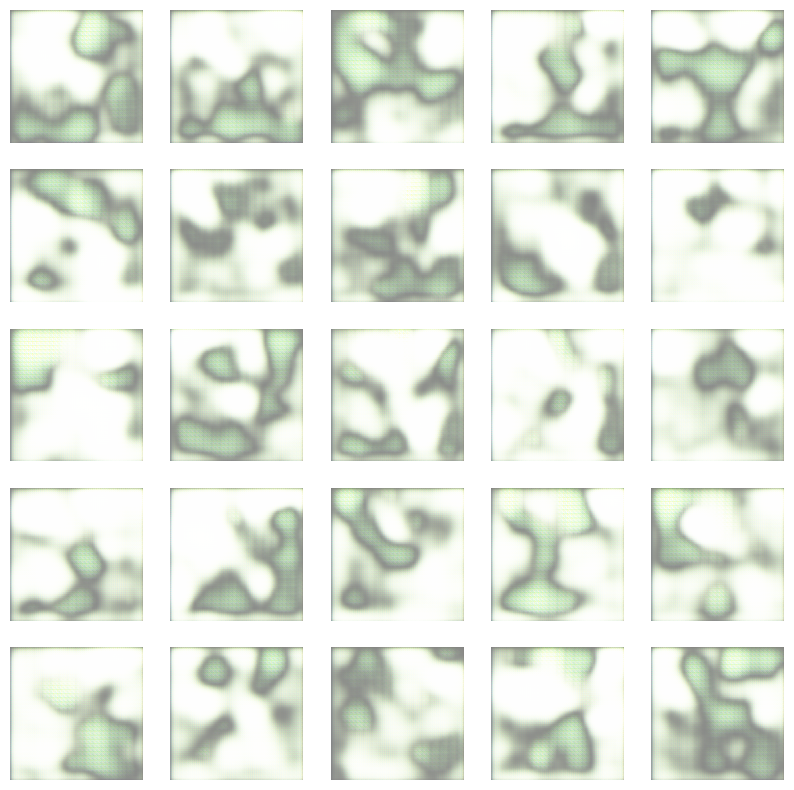

Time for epoch 60 is 3.7197389602661133 sec, mean loss is 1.7105623483657837
4/4 [==============================] - 0s 92ms/step


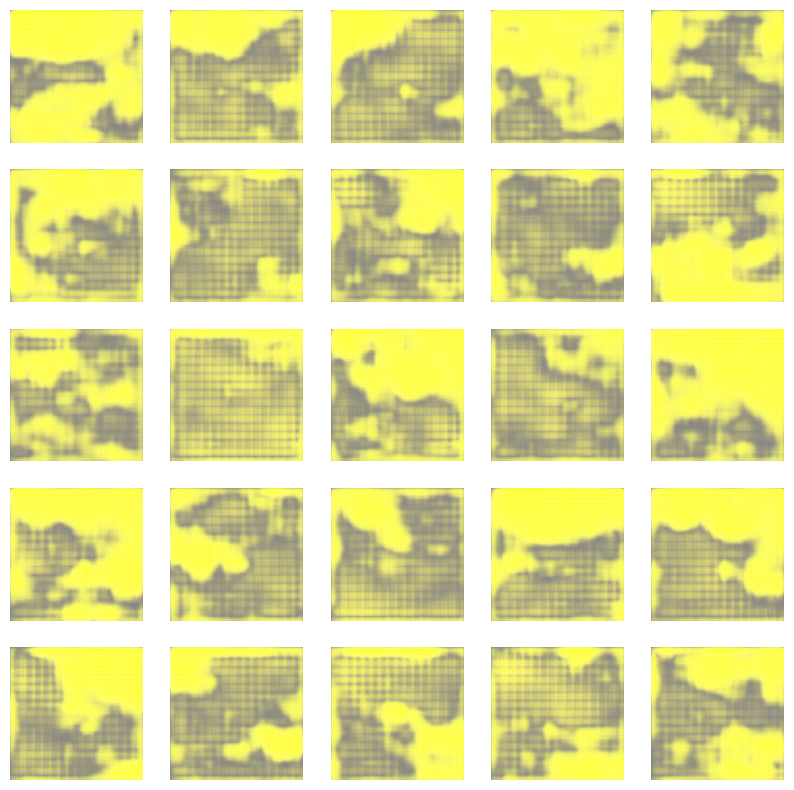

Time for epoch 80 is 4.041283130645752 sec, mean loss is 2.4166572093963623
4/4 [==============================] - 0s 92ms/step


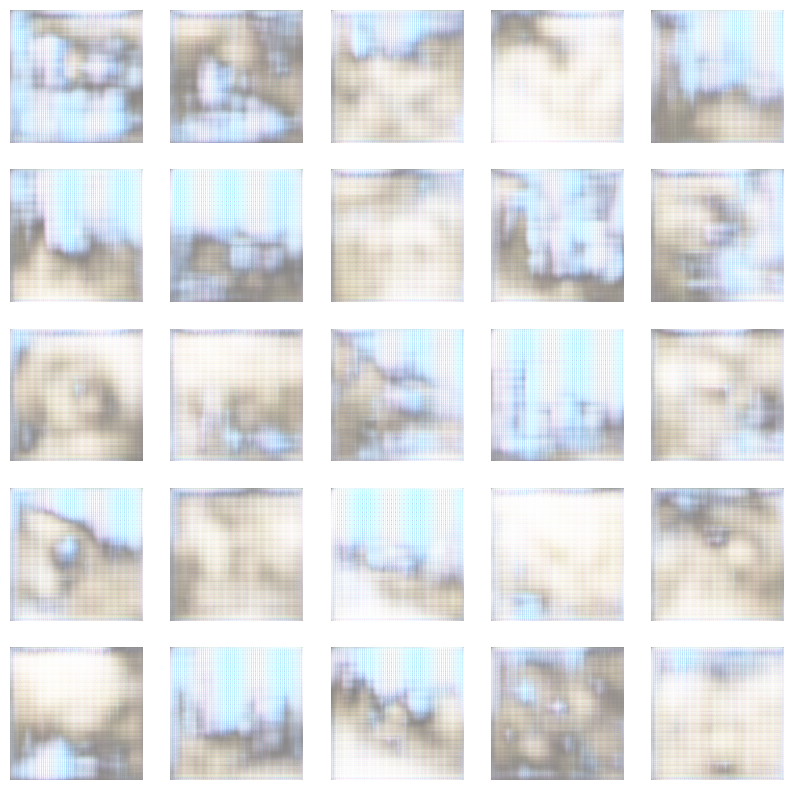

Time for epoch 100 is 4.045517444610596 sec, mean loss is 2.2606287002563477
4/4 [==============================] - 0s 92ms/step


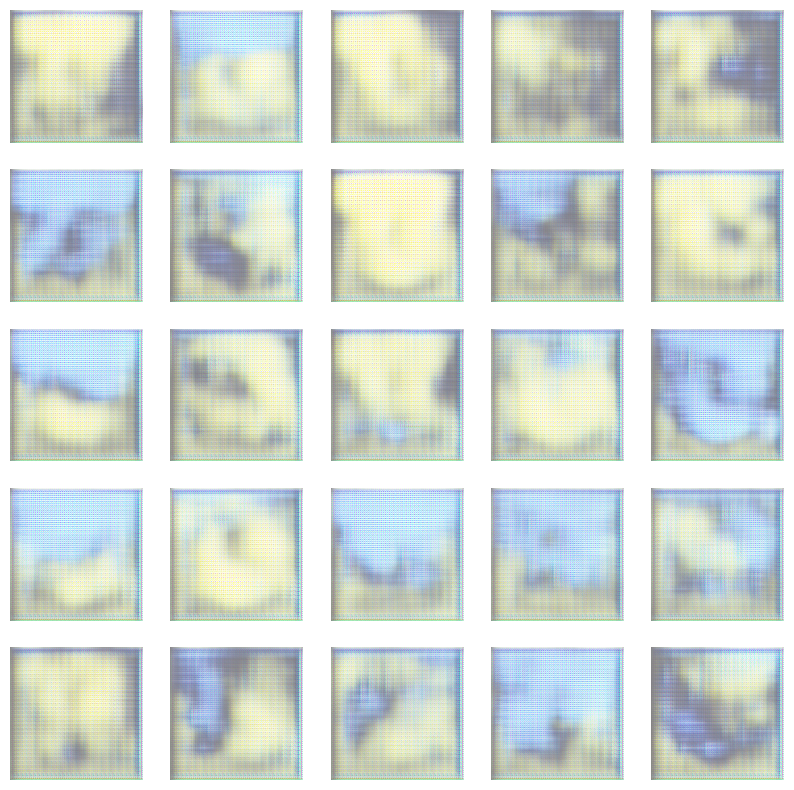

Time for epoch 120 is 4.061919689178467 sec, mean loss is 2.9039604663848877
4/4 [==============================] - 0s 92ms/step


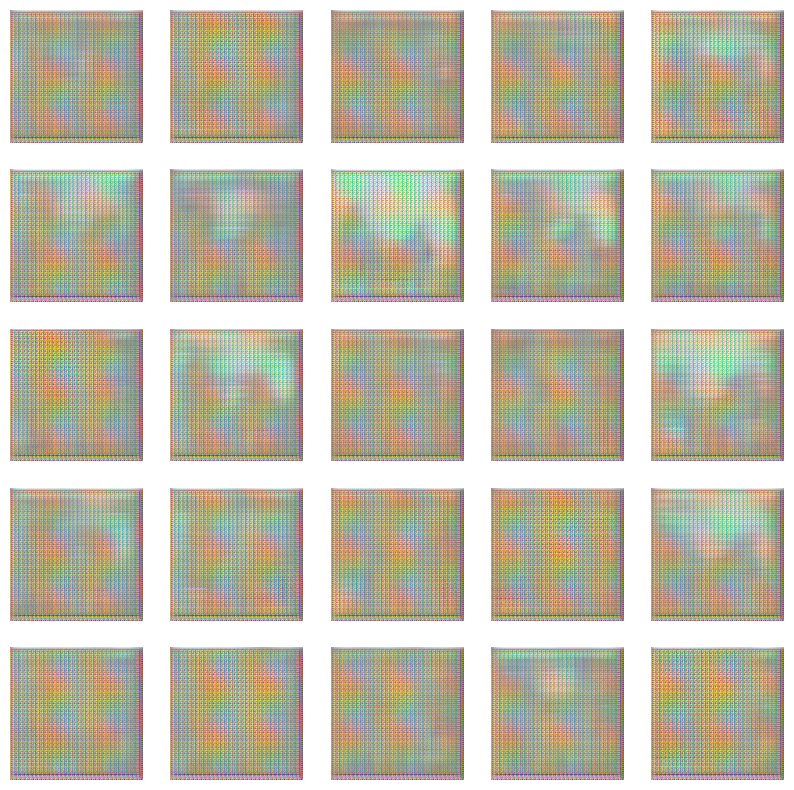

Time for epoch 140 is 4.060781002044678 sec, mean loss is 2.9750900268554688
4/4 [==============================] - 0s 92ms/step


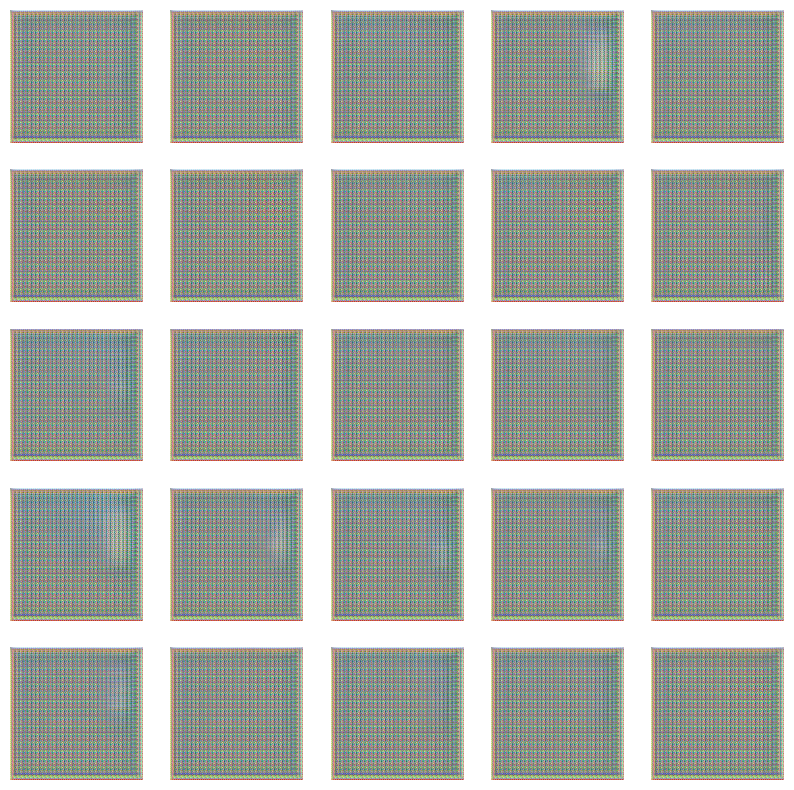

Time for epoch 160 is 4.0698161125183105 sec, mean loss is 4.180117607116699
4/4 [==============================] - 0s 93ms/step


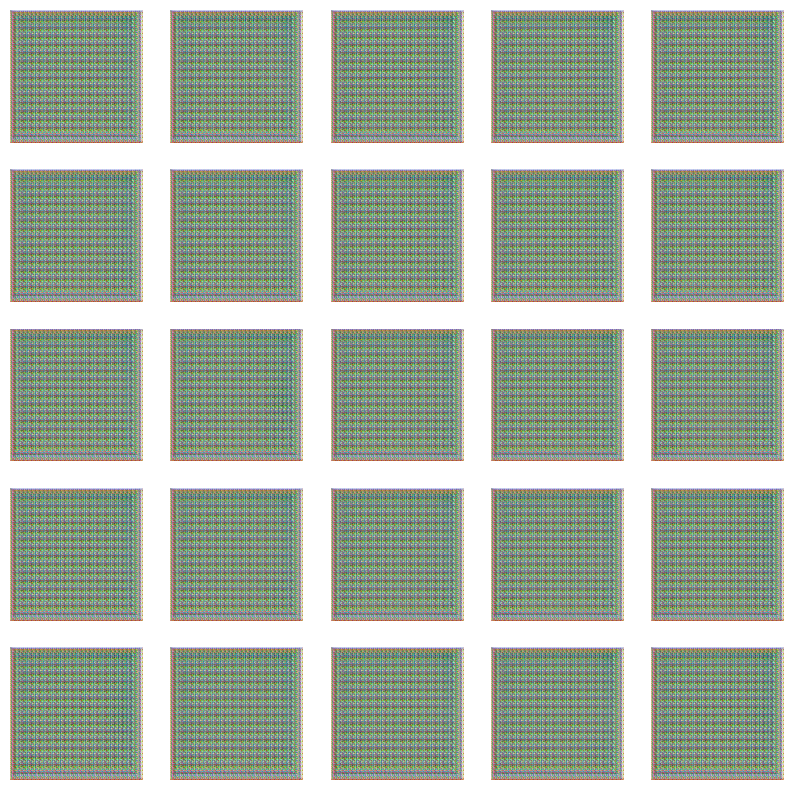

Time for epoch 180 is 4.068751335144043 sec, mean loss is 5.532618999481201
4/4 [==============================] - 0s 92ms/step


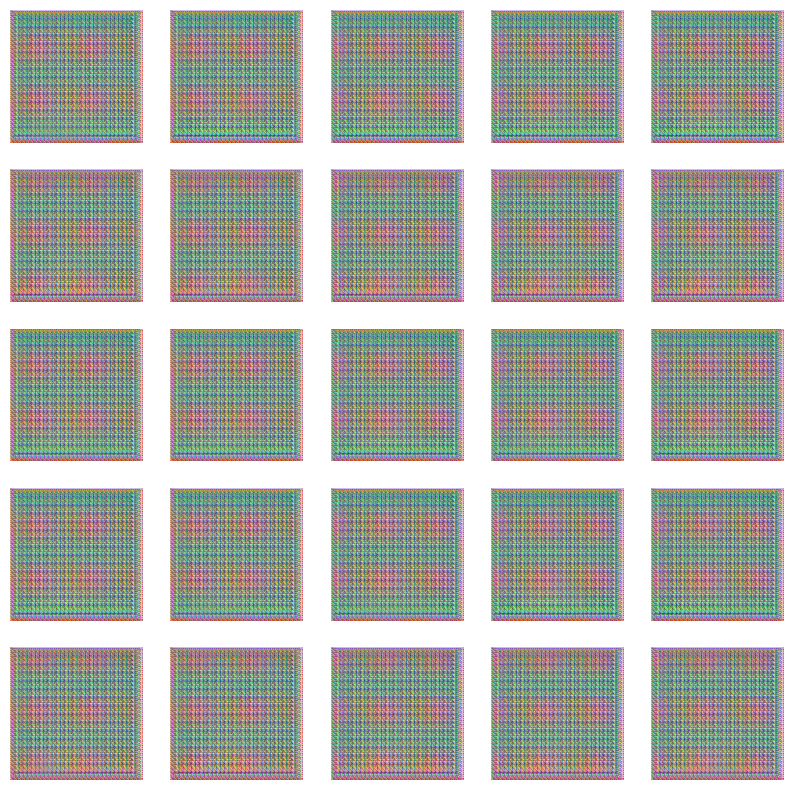

Time for epoch 200 is 4.062723398208618 sec, mean loss is 5.808719635009766
4/4 [==============================] - 0s 92ms/step


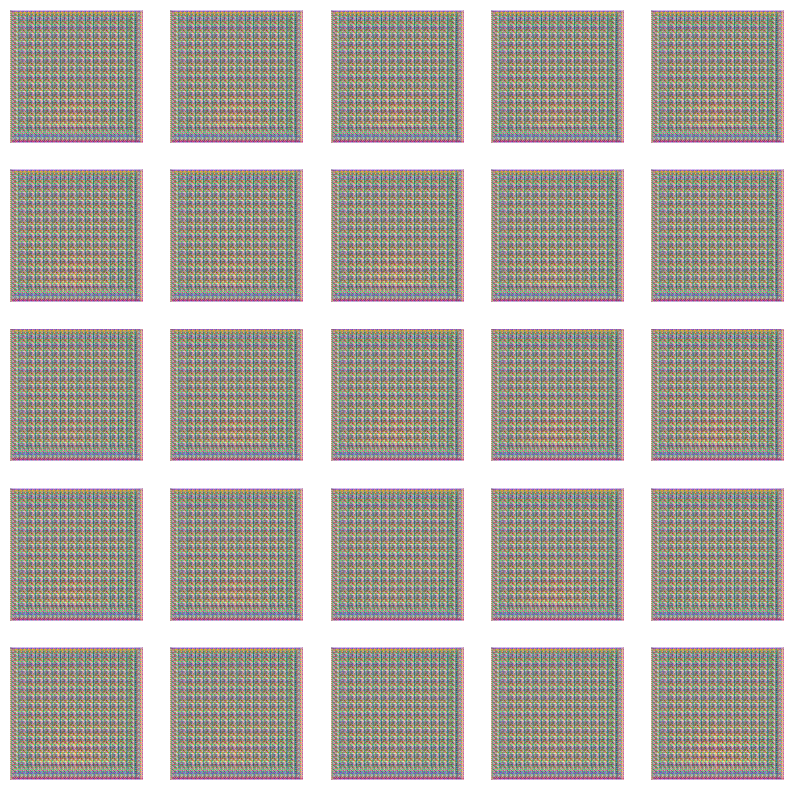

Time for epoch 220 is 4.061384201049805 sec, mean loss is 4.017879009246826
4/4 [==============================] - 0s 92ms/step


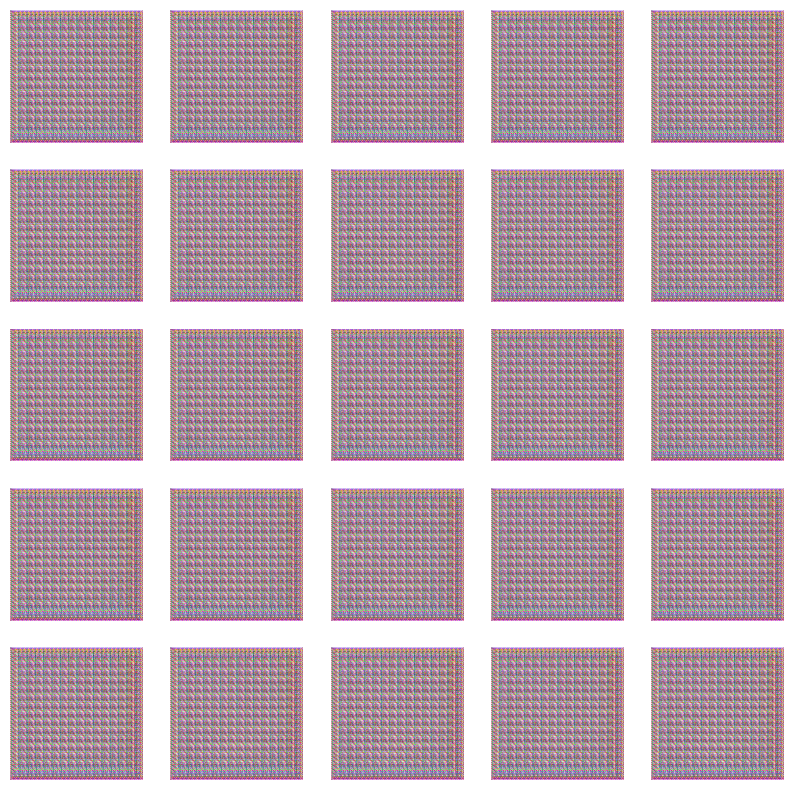

Time for epoch 240 is 4.072357654571533 sec, mean loss is 4.450250625610352
4/4 [==============================] - 0s 92ms/step


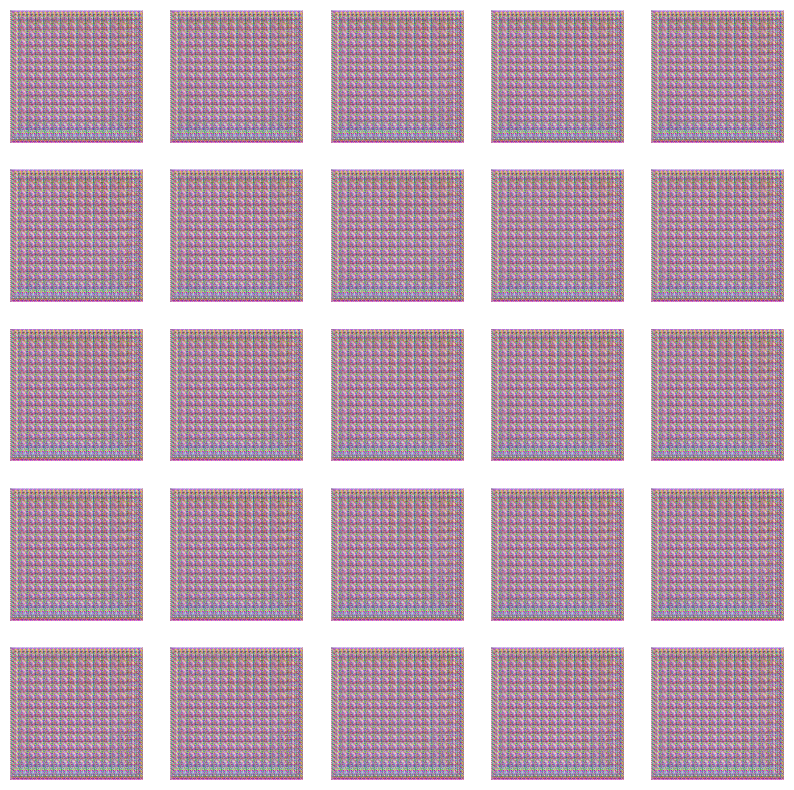

Time for epoch 260 is 4.068749189376831 sec, mean loss is 5.444243907928467
4/4 [==============================] - 0s 92ms/step


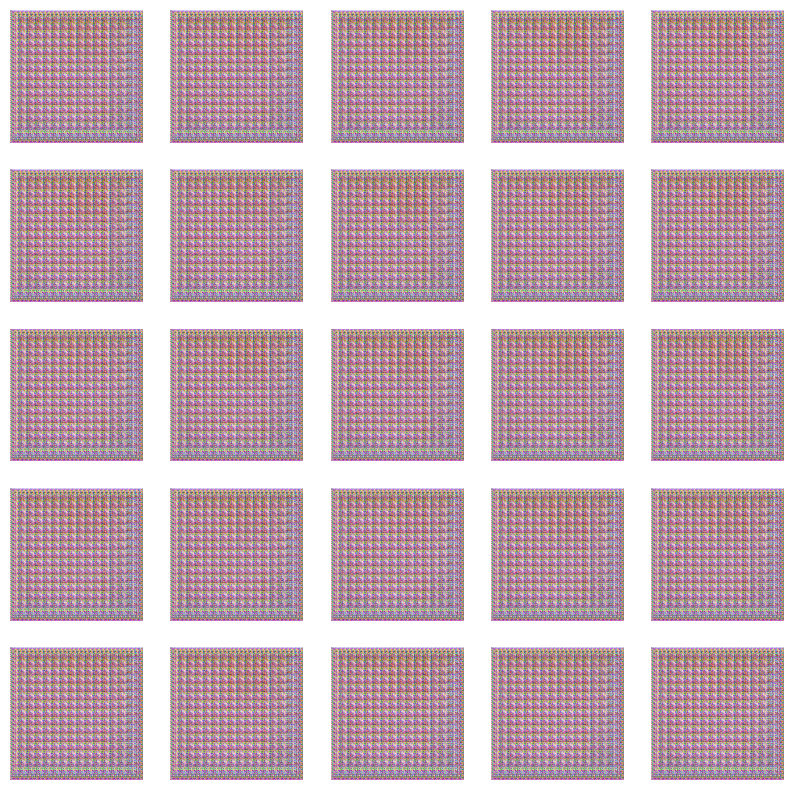

In [ ]:
# train, visualize and print out the result for DCGAN model
gan1 = DCGAN_model(noise_dim, EPOCHS, BATCH_SIZE, generator2, discriminator2, train_dataset)
res1 = gan1.train_loop()
res1

In [ ]:
res1

In [ ]:
gan1.generate_and_plot_images()

In [ ]:
from PIL import Image
import torchvision.transforms as transforms

transforms_ = [
    transforms.Resize(int(img_height*1.12), Image.BICUBIC),
    transforms.RandomCrop((img_height, img_width)),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
]